<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Introduction" data-toc-modified-id="Introduction-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Introduction</a></span></li><li><span><a href="#Libraries" data-toc-modified-id="Libraries-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Libraries</a></span></li><li><span><a href="#Data" data-toc-modified-id="Data-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Data</a></span></li><li><span><a href="#Data-Exploration-and-Optimization" data-toc-modified-id="Data-Exploration-and-Optimization-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Data Exploration and Optimization</a></span></li><li><span><a href="#Identifying-the-Categories-of-the-Products." data-toc-modified-id="Identifying-the-Categories-of-the-Products.-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Identifying the Categories of the Products.</a></span></li><li><span><a href="#Analysis" data-toc-modified-id="Analysis-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Analysis</a></span></li><li><span><a href="#Analyzing-the-Number-of-Units" data-toc-modified-id="Analyzing-the-Number-of-Units-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Analyzing the Number of Units</a></span></li><li><span><a href="#Analyzing-the-Revenue" data-toc-modified-id="Analyzing-the-Revenue-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Analyzing the Revenue</a></span></li><li><span><a href="#Testing-the-Hypotheses" data-toc-modified-id="Testing-the-Hypotheses-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Testing the Hypotheses</a></span><ul class="toc-item"><li><span><a href="#Units-Sold-Test" data-toc-modified-id="Units-Sold-Test-9.1"><span class="toc-item-num">9.1&nbsp;&nbsp;</span>Units Sold Test</a></span></li><li><span><a href="#Revenue" data-toc-modified-id="Revenue-9.2"><span class="toc-item-num">9.2&nbsp;&nbsp;</span>Revenue</a></span></li></ul></li><li><span><a href="#Dashboard" data-toc-modified-id="Dashboard-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>Dashboard</a></span></li><li><span><a href="#Presentation" data-toc-modified-id="Presentation-11"><span class="toc-item-num">11&nbsp;&nbsp;</span>Presentation</a></span></li><li><span><a href="#Conclusions" data-toc-modified-id="Conclusions-12"><span class="toc-item-num">12&nbsp;&nbsp;</span>Conclusions</a></span></li></ul></div>

# Final Project


# E-Commerce: Product Range Analysis.


## Introduction


In the following project, I will be analyzing the data from an online store that sells household goods.  

I will seek to answer the following questions:    

1. Are there specific product categories that can be inferred from the data? 


2. What category is more profitable?   


3. Do different categories sell differently on different months?  


4. What is the best-selling product revenue-wise / units sold-wise?  


5. Testing Hypothesis - I will compare the proportions of the top two categories in revenue and top two categories in number of items sold. If those are the same, I will take top 3 categories in revenue and test their proportions.  
H0: Proportions of category 1 == proportions of category 2   
H2: Proportions of category 1 != proportions of category 2 

---

To answer the above questions, I will take the following steps:  

**1. Analyze the data and prepare it for analysis:**    

> Check for missing and duplicated values and correct them if needed. 

> Change columns to appropriate data types. 

> Transform the data to prepare it for analysis.  

> Create additional columns for date, month, and total revenue. 


**2. Conduct the analysis:**   

> Analyze the product description column.  

> Define the categories.  

> Add a column that contains categories.  

> Analyze the data in light of the created categories and the posed questions.  


**3. Test the hypotheses:**   

> Define the groups for the tests.  

> Formulate the null and alternative hypotheses.  

> Test the hypotheses.  


**4. Present findings:**

> Create a dashboard.  

> Create a presentation with key findings.  


**5. Write conclusions**   


## Libraries


In [2]:
import pandas as pd

import numpy as np

import datetime as dt

import matplotlib.pyplot as plt

import seaborn as sns

import plotly.express as px

from plotly import graph_objects as go

from math import factorial

from scipy import stats as st

import nltk

from nltk.stem import SnowballStemmer

from nltk.stem import WordNetLemmatizer

from collections import Counter

english_stemmer = SnowballStemmer('english')

wordnet_lemma = WordNetLemmatizer()

import sys
import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore");

In [3]:
sns.set_palette('crest') 

## Data


In [4]:
try:
    e_comm = pd.read_csv('/datasets/ecommerce_dataset_us.csv', sep='\t')
except:
    e_comm = pd.read_csv('C:/Users/Layet/Desktop/Projects/Final Project/ecommerce_dataset_us.csv', sep='\t')

## Data Exploration and Optimization


In [5]:
e_comm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 7 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 28.9+ MB


From the get go, I can see that there are some possible issues that require my attention.   
Some missing values in the description and customer id columns.   
Customer ids as floats


In [6]:
e_comm.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,11/29/2018 08:26,2.55,17850.0
1,536365,71053,WHITE METAL LANTERN,6,11/29/2018 08:26,3.39,17850.0
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,11/29/2018 08:26,2.75,17850.0
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,11/29/2018 08:26,3.39,17850.0
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,11/29/2018 08:26,3.39,17850.0


Upper case in the description column and in column names will need to be fixed.


In [7]:
e_comm.describe()

,Quantity,UnitPrice,CustomerID
count,541909.000000,541909.000000,406829.000000
mean,9.552250,4.611114,15287.690570
std,218.081158,96.759853,1713.600303
min,-80995.000000,-11062.060000,12346.000000
25%,1.000000,1.250000,13953.000000
50%,3.000000,2.080000,15152.000000
75%,10.000000,4.130000,16791.000000
max,80995.000000,38970.000000,18287.000000


The negative values in quantity and unit price need to be investigated.  
It looks there are outliers in the unit price column as Q3 is 4.13, but the max is 38970. 
Same is in the quantity column.   
The mean is higher than the median - distribution is skewed to the right for both of those columns. 


In [8]:
e_comm.describe(include=[object])

,InvoiceNo,StockCode,Description,InvoiceDate
count,541909,541909,540455,541909
unique,25900,4070,4223,23260
top,573585,85123A,WHITE HANGING HEART T-LIGHT HOLDER,10/29/2019 14:41
freq,1114,2313,2369,1114


There are 25900 unique invoices in a column of 541909 rows - look like each invoice gets several listings (per item type I presume).  
Same with stock code. Looks like there are 4070 unique items.  
Looks like there is a descrepancy between unique descriptions and stock codes. As there are no missing values in the stock code column, I assume that means that items with same stock code can be described differently. Possible explanations are typos, register, missing descrition.    



In [9]:
e_comm.columns

Index(['InvoiceNo', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'UnitPrice', 'CustomerID'],
      dtype='object')

In [10]:
e_comm.rename(
    columns = {'InvoiceNo': 'invoice_num', 
               'StockCode': 'stock_code', 
               'InvoiceDate': 'invoice_date', 
               'UnitPrice': 'unit_price',
               'CustomerID': 'customer_id'}, inplace=True
)
e_comm.columns = e_comm.columns.str.lower()
e_comm.columns

Index(['invoice_num', 'stock_code', 'description', 'quantity', 'invoice_date',
       'unit_price', 'customer_id'],
      dtype='object')

Updating column names to created a more unified appearance that I am more comfortable to work with.  


In [11]:
e_comm['invoice_date'] = pd.to_datetime(e_comm['invoice_date'])
e_comm['date'] = e_comm['invoice_date'].dt.date
e_comm['date'] = pd.to_datetime(e_comm['date'])
e_comm['month'] = pd.to_datetime(e_comm['invoice_date']).apply(lambda x:x.strftime('%m-%Y'))
e_comm.sample()

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month
476827,577034,51014C,"FEATHER PEN,COAL BLACK",12,2019-11-15 13:16:00,0.39,12847.0,2019-11-15,11-2019


In [12]:
display(e_comm['invoice_date'].min())
display(e_comm['invoice_date'].max())

Timestamp('2018-11-29 08:26:00')

Timestamp('2019-12-07 12:50:00')

Timestamp column changed to appropriate type.  
Columns for date and month created. 


In [13]:
e_comm['description'] = e_comm['description'].str.lower()
e_comm['description'].value_counts()

white hanging heart t-light holder     2369
regency cakestand 3 tier               2200
jumbo bag red retrospot                2159
party bunting                          1727
lunch bag red retrospot                1638
                                       ... 
historic computer difference?....se       1
ruby glass necklace 42"                   1
wrong barcode                             1
barcode problem                           1
blue gingham rose cushion cover           1
Name: description, Length: 4206, dtype: int64

In [14]:
e_comm.describe(include=[object])

,invoice_num,stock_code,description,month
count,541909,541909,540455,541909
unique,25900,4070,4206,14
top,573585,85123A,white hanging heart t-light holder,11-2019
freq,1114,2313,2369,86074


As suspected, some of the discrepancies between unique stock codes and unique descriptions were due to register. 


In [15]:
print('The number of duplicated values is', e_comm.duplicated().sum())
print()

print('Number of unique duplicated values in each column')
for i in e_comm[e_comm.duplicated()].columns:
    print(i,':', e_comm[e_comm.duplicated()][i].nunique())

print()
print('There are duplicated values on the following dates:')
display(e_comm[e_comm.duplicated()]['invoice_date'].dt.date.unique())

print()
print('Number of duplicated row out of total number of rows:')
display(e_comm.duplicated().sum()/len(e_comm))

The number of duplicated values is 5268

Number of unique duplicated values in each column
invoice_num : 1933
stock_code : 1706
description : 1732
quantity : 35
invoice_date : 1914
unit_price : 80
customer_id : 960
date : 298
month : 14

There are duplicated values on the following dates:


array([datetime.date(2018, 11, 29), datetime.date(2018, 11, 30),
       datetime.date(2018, 12, 1), datetime.date(2018, 12, 3),
       datetime.date(2018, 12, 4), datetime.date(2018, 12, 5),
       datetime.date(2018, 12, 6), datetime.date(2018, 12, 7),
       datetime.date(2018, 12, 8), datetime.date(2018, 12, 10),
       datetime.date(2018, 12, 11), datetime.date(2018, 12, 12),
       datetime.date(2018, 12, 13), datetime.date(2018, 12, 14),
       datetime.date(2018, 12, 15), datetime.date(2018, 12, 17),
       datetime.date(2018, 12, 18), datetime.date(2018, 12, 19),
       datetime.date(2018, 12, 20), datetime.date(2018, 12, 21),
       datetime.date(2019, 1, 2), datetime.date(2019, 1, 3),
       datetime.date(2019, 1, 4), datetime.date(2019, 1, 7),
       datetime.date(2019, 1, 8), datetime.date(2019, 1, 9),
       datetime.date(2019, 1, 10), datetime.date(2019, 1, 11),
       datetime.date(2019, 1, 12), datetime.date(2019, 1, 14),
       datetime.date(2019, 1, 15), datetime.date


Number of duplicated row out of total number of rows:


0.009721189350979592

There are 5268 duplicated rows.   
They occur in numerous unique values, accross all columns and on several dates, so there is no regularity to them as far as I can see. 
The total number of duplicates is less than 1% of the total rows.  
Duplicates will be deleted. 


In [16]:
e_comm.drop_duplicates(inplace=True)

Duplicated rows were deleted. 


In [17]:
display(e_comm.isnull().sum())

print()
print('Dates that have missing values.')
e_comm[e_comm['description'].isnull()]['invoice_date'].dt.date.unique()

invoice_num          0
stock_code           0
description       1454
quantity             0
invoice_date         0
unit_price           0
customer_id     135037
date                 0
month                0
dtype: int64


Dates that have missing values.


array([datetime.date(2018, 11, 29), datetime.date(2018, 11, 30),
       datetime.date(2018, 12, 1), datetime.date(2018, 12, 4),
       datetime.date(2018, 12, 5), datetime.date(2018, 12, 6),
       datetime.date(2018, 12, 7), datetime.date(2018, 12, 8),
       datetime.date(2018, 12, 12), datetime.date(2018, 12, 13),
       datetime.date(2018, 12, 15), datetime.date(2018, 12, 18),
       datetime.date(2018, 12, 19), datetime.date(2018, 12, 21),
       datetime.date(2019, 1, 2), datetime.date(2019, 1, 3),
       datetime.date(2019, 1, 4), datetime.date(2019, 1, 8),
       datetime.date(2019, 1, 9), datetime.date(2019, 1, 10),
       datetime.date(2019, 1, 11), datetime.date(2019, 1, 16),
       datetime.date(2019, 1, 17), datetime.date(2019, 1, 18),
       datetime.date(2019, 1, 19), datetime.date(2019, 1, 22),
       datetime.date(2019, 1, 24), datetime.date(2019, 1, 25),
       datetime.date(2019, 1, 26), datetime.date(2019, 1, 30),
       datetime.date(2019, 1, 31), datetime.date(201

There are missing values in the descrption and customer id columns. 
There is a known issue of logging customer ids on some dates for first time customers. For now I leave them as they are and work around that.  
The missing values in the description column will be investigated further.  


In [18]:
no_desc = e_comm[e_comm['description'].isnull()]
display(no_desc)
print()
no_desc['unit_price'].value_counts()

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month
622,536414,22139,NaN,56,2018-11-29 11:52:00,0.0,NaN,2018-11-29,11-2018
1970,536545,21134,NaN,1,2018-11-29 14:32:00,0.0,NaN,2018-11-29,11-2018
1971,536546,22145,NaN,1,2018-11-29 14:33:00,0.0,NaN,2018-11-29,11-2018
1972,536547,37509,NaN,1,2018-11-29 14:33:00,0.0,NaN,2018-11-29,11-2018
1987,536549,85226A,NaN,1,2018-11-29 14:34:00,0.0,NaN,2018-11-29,11-2018
...,...,...,...,...,...,...,...,...,...
535322,581199,84581,NaN,-2,2019-12-05 18:26:00,0.0,NaN,2019-12-05,12-2019
535326,581203,23406,NaN,15,2019-12-05 18:31:00,0.0,NaN,2019-12-05,12-2019
535332,581209,21620,NaN,6,2019-12-05 18:35:00,0.0,NaN,2019-12-05,12-2019
536981,581234,72817,NaN,27,2019-12-06 10:33:00,0.0,NaN,2019-12-06,12-2019


0.0    1454
Name: unit_price, dtype: int64

All rows without a description, have 0 in unit price. As the plan is to calculate revenue, all those rows will be multiplied by zero, which will create null values again and will not contribute to the revenue calculations.  
If there were values in the unit price colum I might have tried to recreate the missing values by using the stock code column. 
I will delete those rows as well as any other rows with 0 in the unit price. 


In [19]:
e_comm[e_comm['unit_price'] == 0]

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month
622,536414,22139,NaN,56,2018-11-29 11:52:00,0.0,NaN,2018-11-29,11-2018
1970,536545,21134,NaN,1,2018-11-29 14:32:00,0.0,NaN,2018-11-29,11-2018
1971,536546,22145,NaN,1,2018-11-29 14:33:00,0.0,NaN,2018-11-29,11-2018
1972,536547,37509,NaN,1,2018-11-29 14:33:00,0.0,NaN,2018-11-29,11-2018
1987,536549,85226A,NaN,1,2018-11-29 14:34:00,0.0,NaN,2018-11-29,11-2018
...,...,...,...,...,...,...,...,...,...
536981,581234,72817,NaN,27,2019-12-06 10:33:00,0.0,NaN,2019-12-06,12-2019
538504,581406,46000M,polyester filler pad 45x45cm,240,2019-12-06 13:58:00,0.0,NaN,2019-12-06,12-2019
538505,581406,46000S,polyester filler pad 40x40cm,300,2019-12-06 13:58:00,0.0,NaN,2019-12-06,12-2019
538554,581408,85175,NaN,20,2019-12-06 14:06:00,0.0,NaN,2019-12-06,12-2019


In [20]:
e_comm.drop(e_comm[e_comm['unit_price'] == 0].index, inplace=True)

In [21]:
e_comm[e_comm['unit_price'] == 0]

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month


All rows with zero price were deleted. 


In [22]:
e_comm[e_comm['unit_price'] < 0]

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month
299983,A563186,B,adjust bad debt,1,2019-08-10 14:51:00,-11062.06,NaN,2019-08-10,08-2019
299984,A563187,B,adjust bad debt,1,2019-08-10 14:52:00,-11062.06,NaN,2019-08-10,08-2019


In [23]:
e_comm[e_comm['quantity'] <= 0]

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month
141,C536379,D,discount,-1,2018-11-29 09:41:00,27.50,14527.0,2018-11-29,11-2018
154,C536383,35004C,set of 3 coloured flying ducks,-1,2018-11-29 09:49:00,4.65,15311.0,2018-11-29,11-2018
235,C536391,22556,plasters in tin circus parade,-12,2018-11-29 10:24:00,1.65,17548.0,2018-11-29,11-2018
236,C536391,21984,pack of 12 pink paisley tissues,-24,2018-11-29 10:24:00,0.29,17548.0,2018-11-29,11-2018
237,C536391,21983,pack of 12 blue paisley tissues,-24,2018-11-29 10:24:00,0.29,17548.0,2018-11-29,11-2018
...,...,...,...,...,...,...,...,...,...
540449,C581490,23144,zinc t-light holder stars small,-11,2019-12-07 09:57:00,0.83,14397.0,2019-12-07,12-2019
541541,C581499,M,manual,-1,2019-12-07 10:28:00,224.69,15498.0,2019-12-07,12-2019
541715,C581568,21258,victorian sewing box large,-5,2019-12-07 11:57:00,10.95,15311.0,2019-12-07,12-2019
541716,C581569,84978,hanging heart jar t-light holder,-1,2019-12-07 11:58:00,1.25,17315.0,2019-12-07,12-2019


There are negative values both in quantity column and unit price. Those are important for the analysis as they affect the revenue. 


In [24]:
e_comm['customer_id'] = e_comm['customer_id'].fillna(0).astype(int)

In [25]:
e_comm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 534131 entries, 0 to 541908
Data columns (total 9 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   invoice_num   534131 non-null  object        
 1   stock_code    534131 non-null  object        
 2   description   534131 non-null  object        
 3   quantity      534131 non-null  int64         
 4   invoice_date  534131 non-null  datetime64[ns]
 5   unit_price    534131 non-null  float64       
 6   customer_id   534131 non-null  int32         
 7   date          534131 non-null  datetime64[ns]
 8   month         534131 non-null  object        
dtypes: datetime64[ns](2), float64(1), int32(1), int64(1), object(4)
memory usage: 38.7+ MB


After data cleanup I have 534131 rows. Missing values in customer id were filled with 0 so the column can be change to int. 


In [26]:
e_comm['total'] = e_comm['quantity'] * e_comm['unit_price']
e_comm.sample(5)

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month,total
159466,550336,23050,recycled acapulco mat green,2,2019-04-15 14:55:00,8.25,13089,2019-04-15,04-2019,16.50
66139,541712,21313,glass heart t-light holder,12,2019-01-19 11:19:00,0.85,17890,2019-01-19,01-2019,10.20
207071,554968,22429,enamel measuring jug cream,1,2019-05-25 16:24:00,4.25,17961,2019-05-25,05-2019,4.25
446179,574882,22781,gumball magazine rack,3,2019-11-05 13:45:00,7.65,13599,2019-11-05,11-2019,22.95
361279,568346,21136,painted metal pears assorted,8,2019-09-24 15:28:00,3.12,14096,2019-09-24,09-2019,24.96


The column for total was created


## Identifying the Categories of the Products.  


In [27]:
e_comm['description'].unique()

array(['white hanging heart t-light holder', 'white metal lantern',
       'cream cupid hearts coat hanger', ..., 'letter "u" bling key ring',
       'cream hanging heart t-light holder',
       'paper craft , little birdie'], dtype=object)

In [28]:
list_of_lemmas = []

for description in e_comm['description'].unique():
    words = nltk.word_tokenize(description)
    lemmas = [wordnet_lemma.lemmatize(w, pos = 'n') for w in words]
    for i in lemmas:
        list_of_lemmas.append(i)

Counter(list_of_lemmas)

Counter({'white': 132,
         'hanging': 104,
         'heart': 269,
         't-light': 90,
         'holder': 122,
         'metal': 112,
         'lantern': 26,
         'cream': 51,
         'cupid': 3,
         'coat': 8,
         'hanger': 20,
         'knitted': 8,
         'union': 28,
         'flag': 12,
         'hot': 31,
         'water': 28,
         'bottle': 44,
         'red': 199,
         'woolly': 2,
         'hottie': 1,
         '.': 11,
         'set': 324,
         '7': 8,
         'babushka': 23,
         'nesting': 3,
         'box': 156,
         'glass': 158,
         'star': 72,
         'frosted': 2,
         'hand': 20,
         'warmer': 19,
         'jack': 21,
         'polka': 3,
         'dot': 3,
         'assorted': 59,
         'colour': 38,
         'bird': 50,
         'ornament': 1,
         'poppy': 8,
         "'s": 34,
         'playhouse': 4,
         'bedroom': 1,
         'kitchen': 26,
         'feltcraft': 24,
         'princess': 3,


In [29]:
household_items = ['bottle', 'hottie', 'warmer', 'cosy', 'clock', 'bin', 'basket', 'tool', 'doorstop', 'cushion', 'sewing',
                   'tissue', 'plaster', 'trinket', 'tray', 'squarecushion', 'tag', 'spade', 'repair', 'sow', 'crate', 'scale', 
                   'fob', 'doorbell', 'watering', 'brush', 'planter', 'radio', 'tin', 'chandelier', 'c/cover', 'mirror',
                   'chest', 'doilies', 'doily', 'magnet', 'box', 'mat', 'tidy', 'curtain', 'screwdriver', 'storage', 'twine',
                   'ashtray']

decorations = ['ornament', 'doormat', 'sticker', 'tape', 'chain', 'frame', 'coaster', 'doorsign', 'sign', 'line',
               'quilt', 'pot', 'thermometer', 'duck', 'photoframe', 'plant', 'bucket', 'ribbon', 'garland', 'letter',
               'decoration', 'calendar', 'vase', 'birdhouse', 'screen', 'tinsel', 'wicker', 'snowflake', 'nest', 'craft',
               'feltcraft', 'bell', 'art', 'christmas', 'sleigh', 'disco', 'rose', 'trellis', 'pear', 'owl', 'photo',
               'filigree', 'bird', 'marker', 'windmill', 'hanging', 'egg', 'filigris', 'stick', 'rabbit', 'heart', 'sheep',
               'daisy', 'flower', 'pennant']

children = ['playhouse', 'doll', 'block', 'jigsaw', 'money', 'toy', 'bingo', 'skittle', 'skipping', 'domino', 'treasure',
            'speaker', 'rocking', 'bib', 'rake', 'nancy', 'glider', 'helicopter', 'clay', 'spinning', 'teddy', 'baby', 'snake',
            'rounder', 'piggy', 'croquet', 'game', 'naught', 'flag', 'ludo', 'tail', 'sticky', 'tattoo', 'badge', 'fork', 
            'trowel', 'bubble', 'crawlies']

party_and_holiday_goods = ['card', 'wrap', 'wrapping', 'balloon', 'wreath', 'bunting', 'confetti']


school_and_office_supplies = ['globe', 'paint', 'blackboard', 'chalkboard', 'organiser', 'notebook', 'invite', 'drawing',
                              'pencil', 'pen', 'eraser', 'chalk', 'scissor', 'stationery', 'stamp', 'office', 'envelope',
                              'pad', 'journal', 'postcard', 'crayon', 'sketchbook', 'album', 'paperweight', 'cardholder',
                              'notelets', 'address', 'board', 'note', 'school', 'book', "p'weight", 'ruler', 'writing',
                              'notepad', 'memoboard', 'sticky']

lighting = ['led', 'nightlight', 'lamp', 'lampshade', 'bulb', 'lightbulb', 'light']

kitchen_items = ['teaspoon', 'jar', 'towel', 'mug', 'cutlery', 'plate', 'case', 'cup', 'teacup', 'jug', 'beaker', 'cloche',
                 'spoon', 'popcorn', 'napkin', 'bowl', 'placemats', 'match', 'cloth', 'tablecloth', 'cutter', 'pannetone',
                 'cakestand', 'stand', 'apron', 'caddy', 'oven', 'place', 'pizza', 'toast', 'platter', 'pan', 'ladle', 
                 'container', 'tumbler', 'flask', 'jam', 'pantry', 'baking', 'tea', 'lunch', 'snack', 'dish', 'recipe', 'salt',
                 'teapot', 'straw', 'frying', 'dispenser', 'flannel', 'breakfast', 'cupcake', 'chocolate', 'tongs', 'food', 
                 'colander', 'mould', 'lolly', 'hamper', 'basin', 'toastrack', 'calculator', 'placemat', 'cocktail']

furniture = ['hanger', 'rack', 'cabinet', 'knob', 'coathanger', 'doorknob', 'sideboard', 'clothes', 'looking', 'drawerknob', 
             'longboard', 'shelf', 'hammock', 'chair', 'peg', 'drawer', 'hook', 'stool']

accessories = ['handbag', 'parasol', 'shopper', 'tote', 'purse', 'umbrella', 'hat', 'harmonica', 'necklace', 'tassle', 'bangle',
               'slipper', 'hairband', 'hairbands', 'bracelet', 'hair', 'scarf', 'patch', 'poncho', 'keyring', 'earring',
               'necklace+bracelet', 'charlotte', 'charm', 'bag', 'choker', 'jewellery', 'hairslide', 'backpack', 'rucksack', 
               'fan', 'key', 'clip', 'ring', 'filigree', 'keyrings', 'passport', 'neckl', 'brooch']

bath = ['sponge', 'toilet', 'washing', 'soap', 'aid', 'chopstick', 'comb', 'washbag', 'toothpaste', 'gloss']

mood_setting = ['t-light', 'lantern', 'candlestick', 'candleholder', 'incense', 't-lights', 'baroquecandlestick', 'tealight',
                'wick', 'candlepot', 'chocolatecandle', 'incense+flower', 'incense/candle', 'incense/candl', 'incense/cand', 
                'burner', 'oil', 'candle']

general = ['postage', 'dotcom', 'manual', 'debt', 'carriage', 'charge', 'barcode', 'difference', 'fee',
           'discount', 'sample', 'cruk']

def lemmatization_func(line):
    words = nltk.word_tokenize(line)
    lemmas = [wordnet_lemma.lemmatize(w, pos = 'n') for w in words]
    if any(word in lemmas for word in household_items):
        return 'home'
    elif any(word in lemmas for word in decorations):
        return 'decorations'
    elif any(word in lemmas for word in children):
        return 'kids'
    elif any(word in lemmas for word in party_and_holiday_goods):
        return 'party/holiday'
    elif any(word in lemmas for word in school_and_office_supplies):
        return 'school/office'
    elif any(word in lemmas for word in lighting):
        return 'illumination'
    elif any(word in lemmas for word in kitchen_items):
        return 'kitchen'
    elif any(word in lemmas for word in furniture):
        return 'furniture'
    elif any(word in lemmas for word in accessories):
        return 'accessories'
    elif any(word in lemmas for word in bath):
        return 'bath'
    elif any(word in lemmas for word in mood_setting):
        return 'mood'
    elif any(word in lemmas for word in general):
        return 'other charges'
    else:
        return 'other'

In [30]:
e_comm['category'] = e_comm['description'].apply(lemmatization_func)
e_comm.head()

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month,total,category
0,536365,85123A,white hanging heart t-light holder,6,2018-11-29 08:26:00,2.55,17850,2018-11-29,11-2018,15.30,decorations
1,536365,71053,white metal lantern,6,2018-11-29 08:26:00,3.39,17850,2018-11-29,11-2018,20.34,mood
2,536365,84406B,cream cupid hearts coat hanger,8,2018-11-29 08:26:00,2.75,17850,2018-11-29,11-2018,22.00,decorations
3,536365,84029G,knitted union flag hot water bottle,6,2018-11-29 08:26:00,3.39,17850,2018-11-29,11-2018,20.34,home
4,536365,84029E,red woolly hottie white heart.,6,2018-11-29 08:26:00,3.39,17850,2018-11-29,11-2018,20.34,home


In [31]:
e_comm['category'].value_counts()

decorations      162116
home             115885
kitchen           94872
accessories       42449
school/office     27887
party/holiday     27257
kids              19325
furniture         14939
mood              14769
other              4874
illumination       4187
other charges      2988
bath               2583
Name: category, dtype: int64

In [32]:
cat_check = e_comm[e_comm['category'] == 'other']
cat_check['description'].value_counts()

felt farm animal white bunny      98
kids rain mac pink                95
regency cake slice                93
grow your own herbs set of 3      92
kids rain mac blue                89
                                  ..
blue flying singing canary         1
ooh la la dogs collar              1
camouflage dog collar              1
blackchristmas tree 30cm           1
set of 6 easter rainbow chicks     1
Name: description, Length: 190, dtype: int64

The products were catgorized and devided into 13 categories. The "other" category includes items with less than 100 listings. The "other charges" category includes non-product listings like, discounts, fees, postage. As I am looking at products, I will remove that category before analysis. 


In [33]:
other_charges = e_comm[e_comm['category'] == 'other charges']
other_charges.head()

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month,total,category
45,536370,POST,postage,3,2018-11-29 08:45:00,18.0,12583,2018-11-29,11-2018,54.0,other charges
141,C536379,D,discount,-1,2018-11-29 09:41:00,27.5,14527,2018-11-29,11-2018,-27.5,other charges
386,536403,POST,postage,1,2018-11-29 11:27:00,15.0,12791,2018-11-29,11-2018,15.0,other charges
1123,536527,POST,postage,1,2018-11-29 13:04:00,18.0,12662,2018-11-29,11-2018,18.0,other charges
1423,536540,C2,carriage,1,2018-11-29 14:05:00,50.0,14911,2018-11-29,11-2018,50.0,other charges


In [34]:
other_charges['description'].value_counts()

postage              1252
dotcom postage        707
manual                561
carriage              143
next day carriage      80
discount               77
samples                62
bank charges           37
amazon fee             34
packing charge         16
cruk commission        16
adjust bad debt         3
Name: description, dtype: int64

In [35]:
other_charges.groupby(['description']).agg({'quantity': 'sum', 'total': 'sum'})

,quantity,total
description,,
adjust bad debt,3,-11062.060
amazon fee,-30,-221520.500
bank charges,-13,-7175.639
carriage,140,6986.000
cruk commission,-16,-7933.430
discount,-1194,-5696.220
dotcom postage,705,206245.480
manual,2919,-69031.640
next day carriage,78,1185.000


The list above greatly affects the revenue of the company, however, I am analyzing the products and the income they generate.  
If and when revenue is anlyzed, those will have to be taken into the account in the calculation.  


In [36]:
e_comm_products = e_comm.drop(e_comm[e_comm['category'] == 'other charges'].index)
e_comm_products['category'].value_counts()

decorations      162116
home             115885
kitchen           94872
accessories       42449
school/office     27887
party/holiday     27257
kids              19325
furniture         14939
mood              14769
other              4874
illumination       4187
bath               2583
Name: category, dtype: int64

In [37]:
e_comm_products['category'].describe()

count          531143
unique             12
top       decorations
freq           162116
Name: category, dtype: object

The "other charges" category was removed from the data. I have 12 categories for analysis. 


## Analysis


In [38]:
e_comm_products.head()

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month,total,category
0,536365,85123A,white hanging heart t-light holder,6,2018-11-29 08:26:00,2.55,17850,2018-11-29,11-2018,15.30,decorations
1,536365,71053,white metal lantern,6,2018-11-29 08:26:00,3.39,17850,2018-11-29,11-2018,20.34,mood
2,536365,84406B,cream cupid hearts coat hanger,8,2018-11-29 08:26:00,2.75,17850,2018-11-29,11-2018,22.00,decorations
3,536365,84029G,knitted union flag hot water bottle,6,2018-11-29 08:26:00,3.39,17850,2018-11-29,11-2018,20.34,home
4,536365,84029E,red woolly hottie white heart.,6,2018-11-29 08:26:00,3.39,17850,2018-11-29,11-2018,20.34,home


In [39]:
categories = e_comm_products.groupby(['category'], as_index=False).agg({'description':'count'}).sort_values(by='description')
categories.columns = ['category', 'num_products']
categories

,category,num_products
1,bath,2583
5,illumination,4187
9,other,4874
8,mood,14769
3,furniture,14939
6,kids,19325
10,party/holiday,27257
11,school/office,27887
0,accessories,42449
7,kitchen,94872


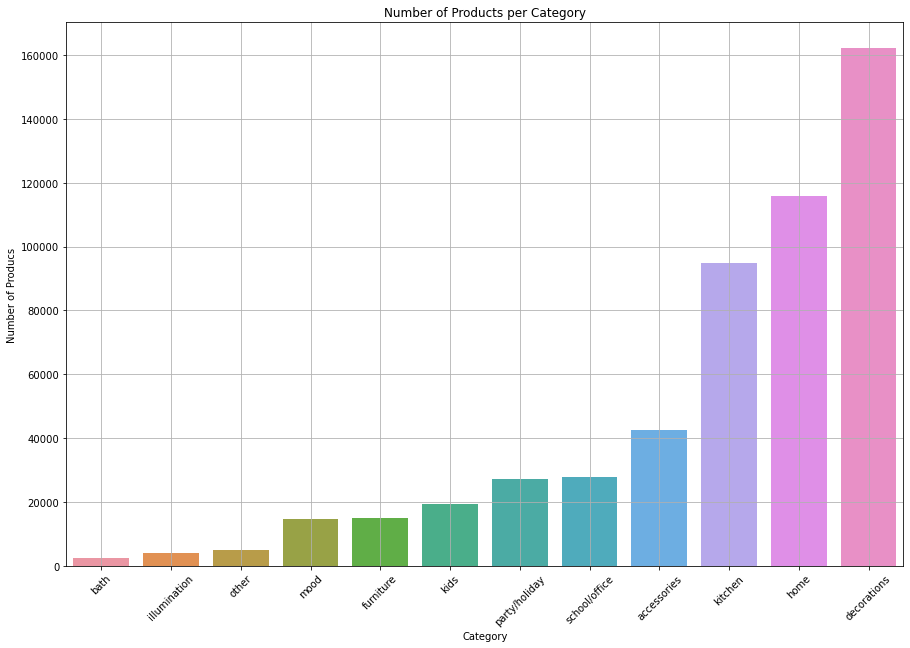

In [40]:
plt.figure(figsize=(15,10))
ax = sns.barplot(x='category', y='num_products', data=categories)
plt.grid()
plt.title('Number of Products per Category')
plt.xlabel('Category')
plt.ylabel('Number of Producs')
plt.xticks(rotation = 45)
plt.show()

The top 3 categories are decorations, home and kitchen.  


In [41]:
fig = go.Figure(go.Pie(labels=categories['category'], values=categories['num_products'],textinfo='label+percent'))
fig.update_layout(title_text='Categories Shares')
fig.show() 

Decorations are 30.5% of the the products sold.  
Products for home are 21.8% and products for kitchen are 17.9%.   
The rest of the categories have less than 10% each.    


In [42]:
fig = px.histogram(e_comm_products, x='invoice_date', title='Event Distribution by Date and Time')
fig.show()

It looks loke there are gaps in the data. There are no invoices between 23.12 and 1.1, as well as 20-22.4. Those are the dates for winter holidays (Christmas/New Yars) and Easter, respectively. It seem the site is not operational during major holidays.  


## Analyzing the Number of Units


In [43]:
units = e_comm_products.groupby(['date', 'month', 'category']).agg({'quantity': 'sum'}).reset_index()
units

,date,month,category,quantity
0,2018-11-29,11-2018,accessories,1836
1,2018-11-29,11-2018,bath,42
2,2018-11-29,11-2018,decorations,8139
3,2018-11-29,11-2018,furniture,574
4,2018-11-29,11-2018,home,6291
...,...,...,...,...
3649,2019-12-07,12-2019,kitchen,1807
3650,2019-12-07,12-2019,mood,756
3651,2019-12-07,12-2019,other,192
3652,2019-12-07,12-2019,party/holiday,669


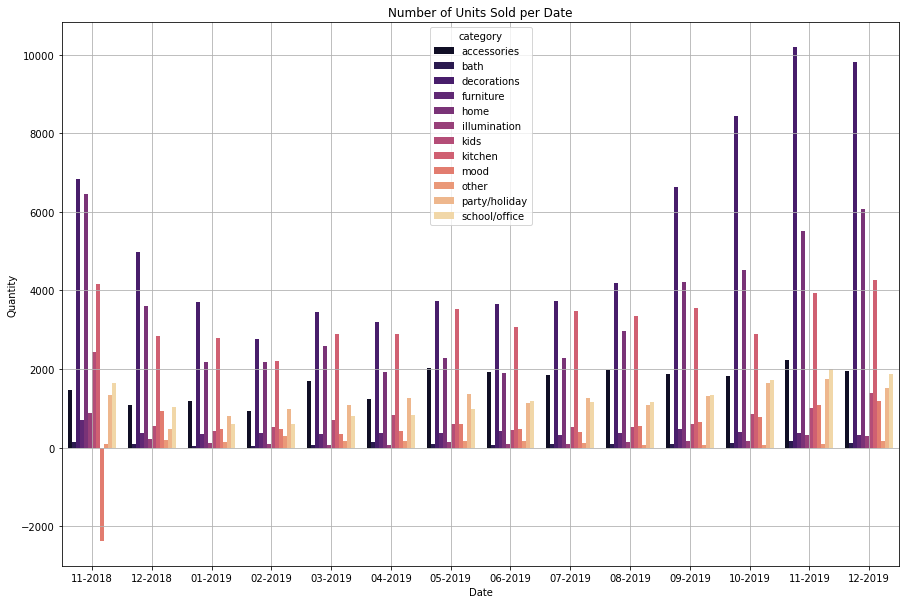

In [44]:
plt.figure(figsize=(15,10))
ax = sns.barplot(x='month', y='quantity', data=units, hue='category', ci=0, palette='magma')
plt.grid()
plt.title('Number of Units Sold per Date')
plt.xlabel('Date')
plt.ylabel('Quantity')
plt.show()


Some categories are more stable than others in terms of units sold (bath).  
With slight variations, the general trend is that there are high numbers in November. Sales go down in December. The reason might be that all gifts were already purchased and the site was not operational during the last week. Winter month are slow and sales start to pik back up again from April on.   
There is a curious negative value for the mood category.


In [45]:
units[units['category'] == 'mood'].sort_values(by = 'quantity')

,date,month,category,quantity
20,2018-11-30,11-2018,mood,-6119
2199,2019-07-18,07-2019,mood,-6
2450,2019-08-12,08-2019,mood,10
1158,2019-04-01,04-2019,mood,34
1398,2019-04-29,04-2019,mood,64
...,...,...,...,...
3470,2019-11-20,11-2019,mood,1770
2630,2019-08-30,08-2019,mood,1797
3614,2019-12-04,12-2019,mood,1888
116,2018-12-10,12-2018,mood,2017


In [46]:
mood_check = e_comm_products[e_comm_products['category'] == 'mood']
mood_check[mood_check['date'] == '2018-11-30'].sort_values(by='quantity')

,invoice_num,stock_code,description,quantity,invoice_date,unit_price,customer_id,date,month,total,category
4287,C536757,84347,rotating silver angels t-light hldr,-9360,2018-11-30 14:23:00,0.03,15838,2018-11-30,11-2018,-280.80,mood
4877,C536814,72799E,ivory pillar candle silver flock,-6,2018-11-30 17:03:00,2.95,13958,2018-11-30,11-2018,-17.70,mood
4881,C536815,85175,cacti t-light candles,-1,2018-11-30 17:05:00,0.42,14443,2018-11-30,11-2018,-0.42,mood
4944,C536829,71477,colour glass. star t-light holder,-1,2018-11-30 17:36:00,3.25,13295,2018-11-30,11-2018,-3.25,mood
4885,C536817,71477,colour glass. star t-light holder,-1,2018-11-30 17:08:00,3.25,14156,2018-11-30,11-2018,-3.25,mood
...,...,...,...,...,...,...,...,...,...,...,...
4464,536783,84347,rotating silver angels t-light hldr,120,2018-11-30 15:19:00,1.88,15061,2018-11-30,11-2018,225.60,mood
3274,536617,72741,grand chocolatecandle,144,2018-11-30 10:17:00,1.25,13941,2018-11-30,11-2018,180.00,mood
3758,536673,40016,chinese dragon paper lanterns,144,2018-11-30 12:11:00,0.42,14060,2018-11-30,11-2018,60.48,mood
4479,536784,84347,rotating silver angels t-light hldr,240,2018-11-30 15:20:00,1.88,15061,2018-11-30,11-2018,451.20,mood


A large invoice was cancelled on this date.


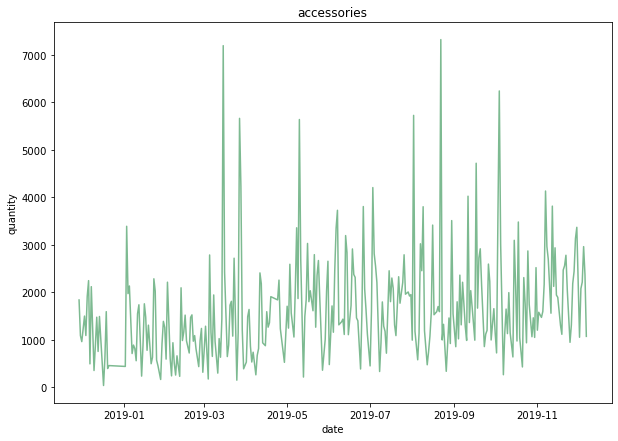

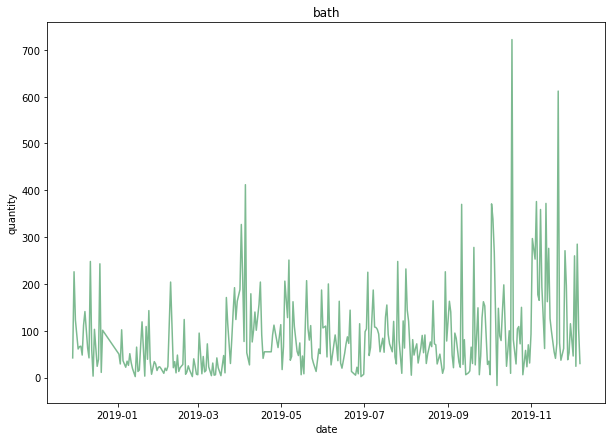

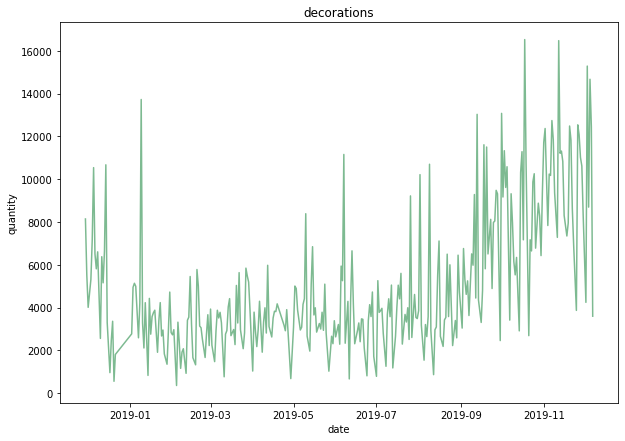

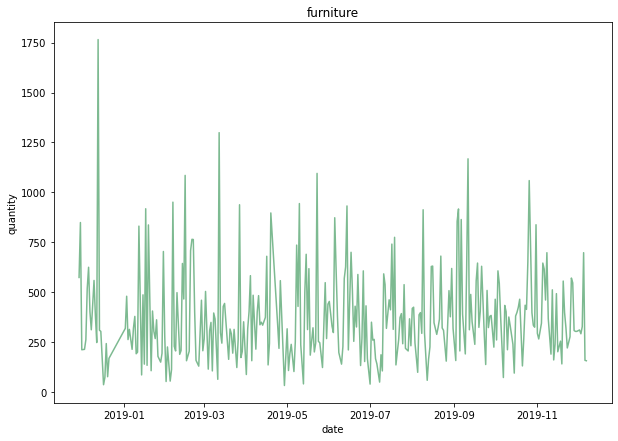

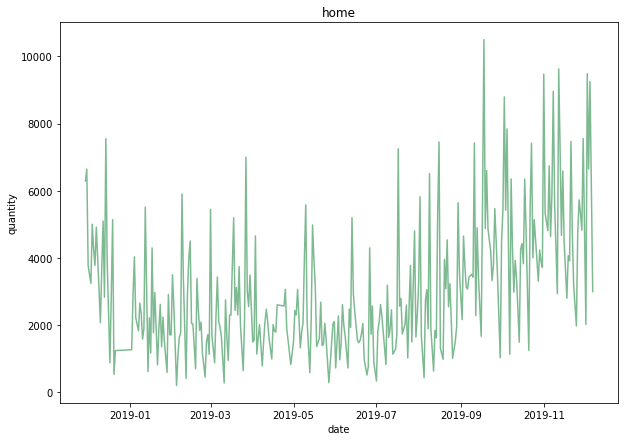

...

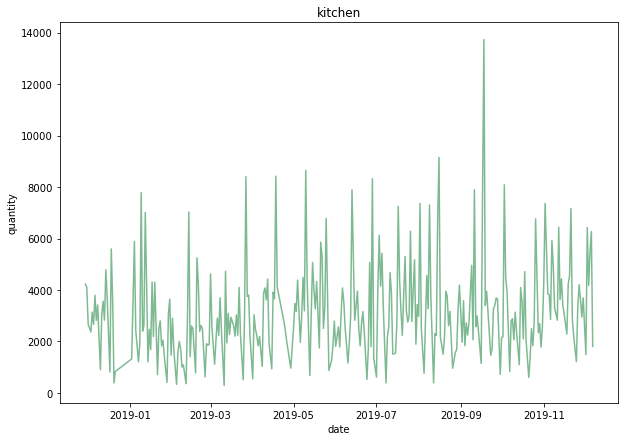

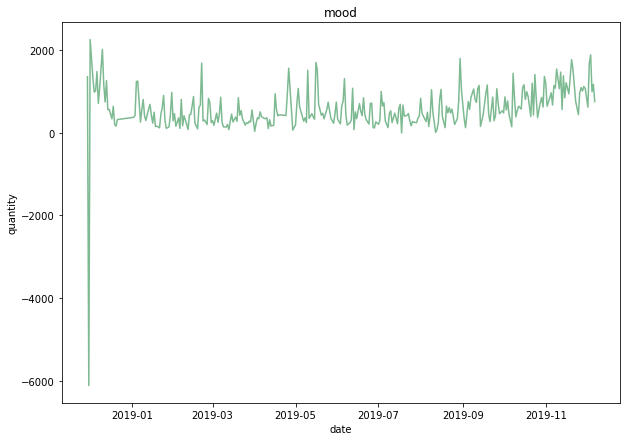

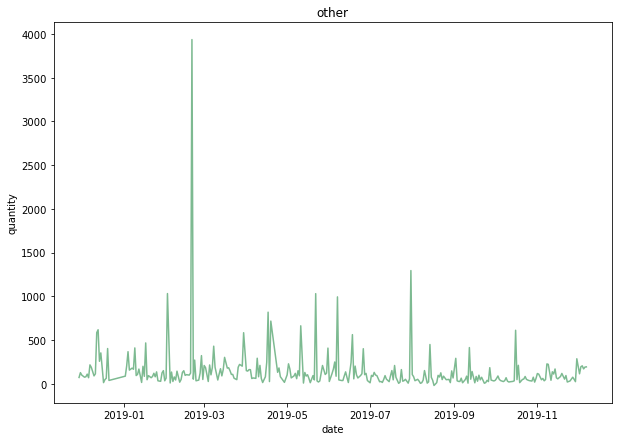

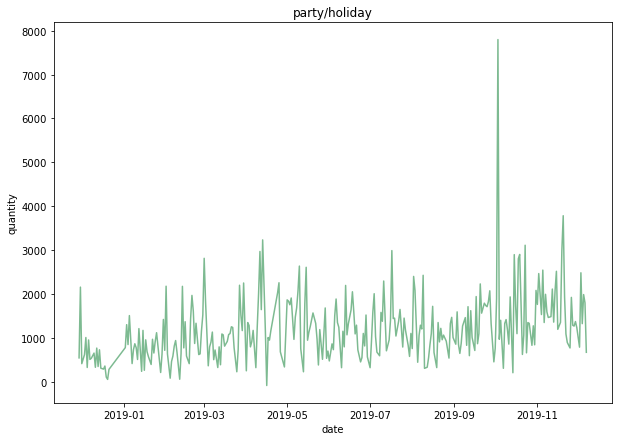

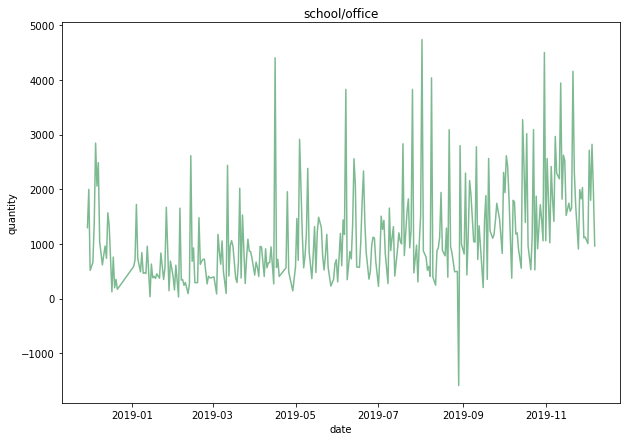

In [47]:
for i in units['category'].unique():
    units_category = units[units['category'] == i]
    plt.figure(figsize=(10,7))
    ax = sns.lineplot(data=units_category, x='date', y='quantity', palette='magma')
    plt.title(i)
    plt.show()



When looking at each category separetly, I note that there are some categories that experience rize in sales starting in the summer, and some remain stable.  
There are peaks and lows for each category. 


In [48]:
e_comm_products.groupby(['category'], as_index=False).agg({'quantity' : 'sum'}).sort_values(by='quantity', ascending=False)

,category,quantity
2,decorations,1538029
7,kitchen,964568
4,home,947094
0,accessories,513190
10,party/holiday,367057
11,school/office,351419
6,kids,201510
8,mood,178270
3,furniture,115494
5,illumination,44303


Decorations have most items sold.  


In [49]:
e_comm_products.groupby(['category']).agg({'quantity' : 'mean'}).sort_values(by='quantity', ascending=False)

,quantity
category,
party/holiday,13.466522
school/office,12.601535
accessories,12.089566
mood,12.070553
illumination,10.581084
bath,10.546651
kids,10.427426
kitchen,10.167046
decorations,9.487213


The highest average number of items sold per invoice belongs to party/holiday category. 


In [50]:
most_popular = e_comm_products.groupby(['category', 'description']).agg({'quantity' : 'sum'}).reset_index()
most_popular

,category,description,quantity
0,accessories,i love london mini backpack,388
1,accessories,i love london mini rucksack,1
2,accessories,red spot gift bag large,1713
3,accessories,5 strand glass necklace amber,6
4,accessories,5 strand glass necklace amethyst,9
...,...,...,...
4025,school/office,wood stamp set best wishes,1017
4026,school/office,wood stamp set happy birthday,933
4027,school/office,wood stamp set thank you,1496
4028,school/office,wooden school colouring set,5607


In [51]:
for i in most_popular['category'].unique():
    top_product = most_popular[most_popular['category'] == i].sort_values(by='quantity', ascending = False).reset_index().head(1)
    print(top_product)

   index     category              description  quantity
0    252  accessories  jumbo bag red retrospot     47256
   index category          description  quantity
0    486     bath  doughnut lip gloss      10335
   index     category                    description  quantity
0    572  decorations  assorted colour bird ornament     36282
   index   category                      description  quantity
0   1798  furniture  clothes pegs retrospot pack 24       8634
   index category                 description  quantity
0   2289     home  pack of 12 london tissues      26095
   index      category                    description  quantity
0   2675  illumination  red toadstool led night light     13815
   index category                        description  quantity
0   2797     kids  world war 2 gliders asstd designs     53751
   index category     description  quantity
0   3109  kitchen  popcorn holder     36322
   index category                   description  quantity
0   3301     mood  antiq

Above are the item that sold the most units in each category.  


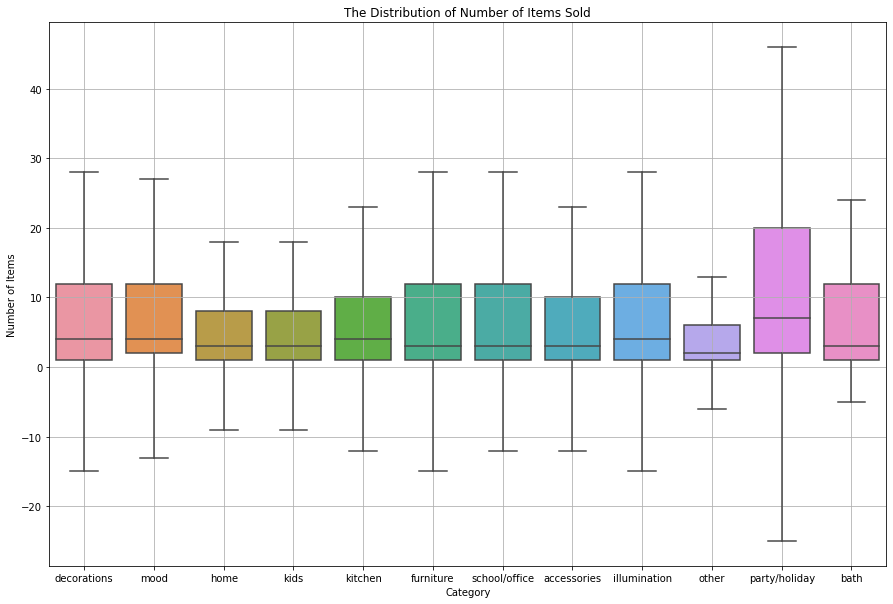

In [52]:
plt.figure(figsize=(15,10))
ax = sns.boxplot(data=e_comm_products, x='category', y='quantity', showfliers=False)
plt.grid()
plt.title('The Distribution of Number of Items Sold')
plt.xlabel('Category')
plt.ylabel('Number of Items')
plt.show()

The party/holiday category has the highest median and a widest spread. This category has the highest mean as well.   
Rest of the categories have very similar medians.  
The lowest median is for the 'other' category.  


## Analyzing the Revenue


In [53]:
revenue = e_comm_products.groupby(['date', 'month', 'category']).agg({'total': 'sum'}).reset_index()
revenue

,date,month,category,total
0,2018-11-29,11-2018,accessories,3906.46
1,2018-11-29,11-2018,bath,87.73
2,2018-11-29,11-2018,decorations,18484.52
3,2018-11-29,11-2018,furniture,1335.83
4,2018-11-29,11-2018,home,16475.87
...,...,...,...,...
3649,2019-12-07,12-2019,kitchen,4484.15
3650,2019-12-07,12-2019,mood,931.25
3651,2019-12-07,12-2019,other,118.18
3652,2019-12-07,12-2019,party/holiday,676.50


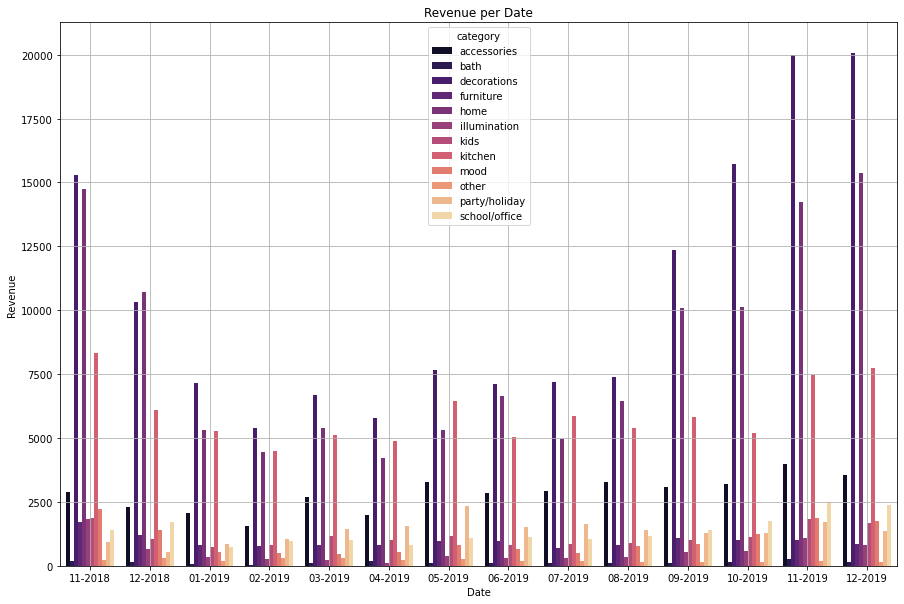

In [54]:
plt.figure(figsize=(15,10))
ax = sns.barplot(x='month', y='total', data=revenue, hue='category', ci=0, palette='magma')
plt.grid()
plt.title('Revenue per Date')
plt.xlabel('Date')
plt.ylabel('Revenue')
plt.show()

Other, party/holiday and school/office categories are relatively  stable throughout the year with slight increase in December.  
In the categories with the highest revenue, we see the same trend: with less sales during the winter months.  
Decorations has slight peak in May, but really goes up in September.   
For accessories, the rise begins as early as March. 


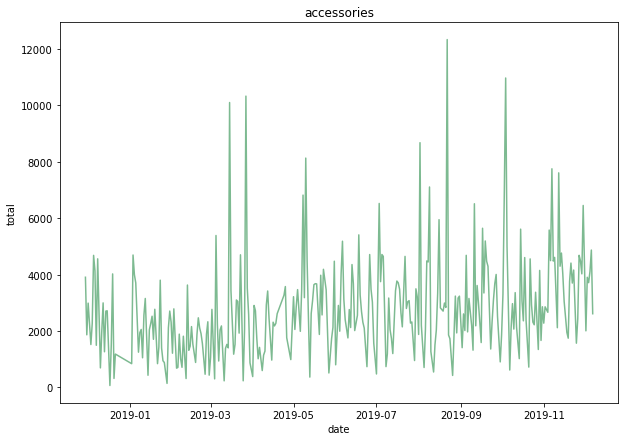

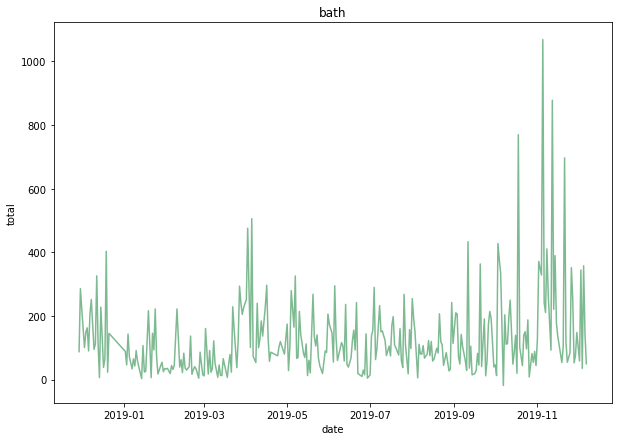

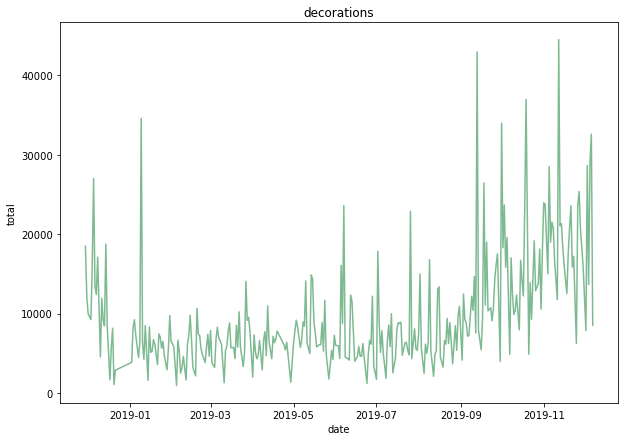

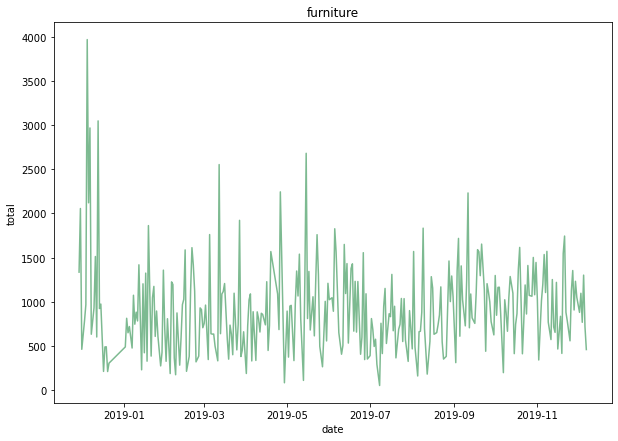

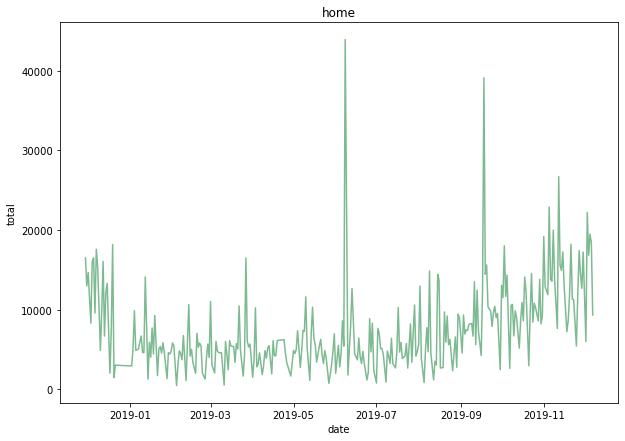

...

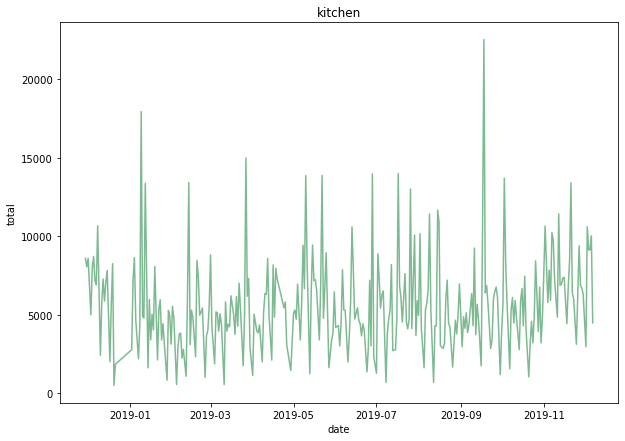

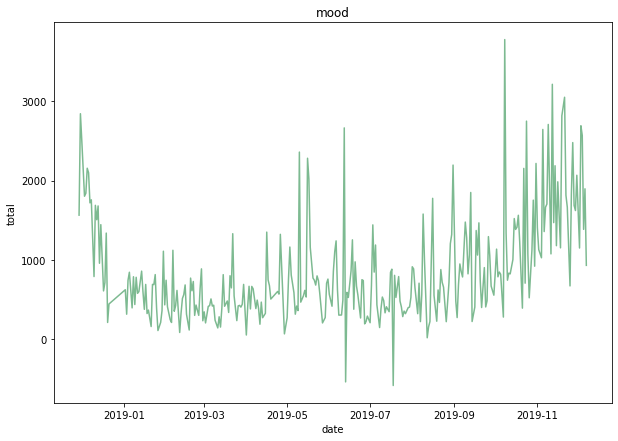

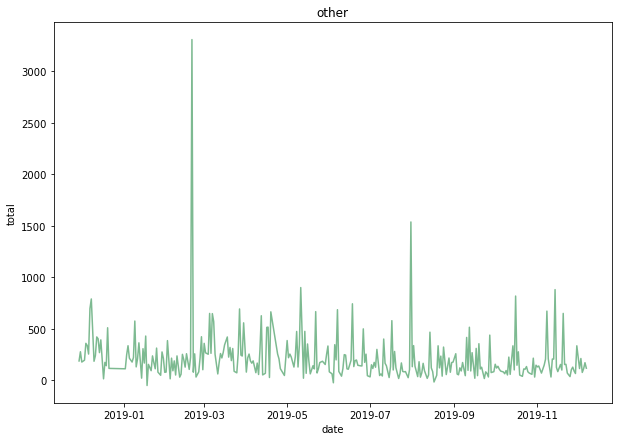

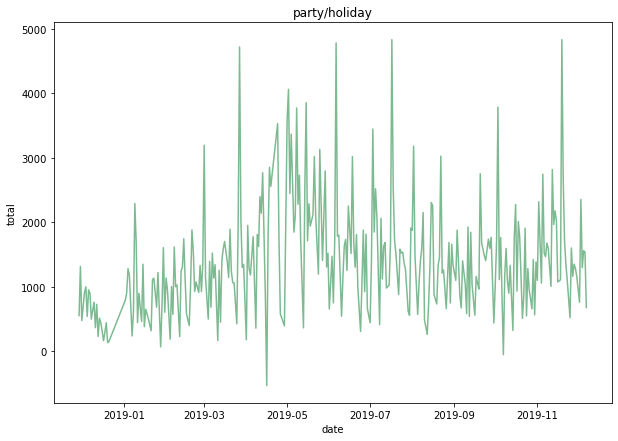

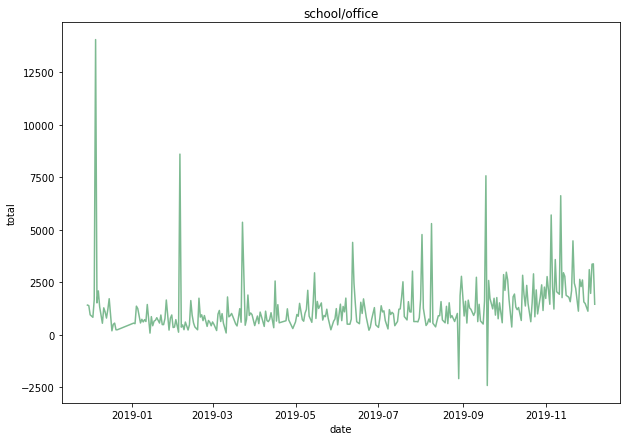

In [55]:
for i in revenue['category'].unique():
    revenue_category = revenue[revenue['category'] == i]
    plt.figure(figsize=(10,7))
    ax = sns.lineplot(data=revenue_category, x='date', y='total', palette='magma')
    plt.title(i)
    plt.show()

In all categories there are sudden peaks and some deep lows throughout the year. 


In [56]:
e_comm_products.groupby(['category'], as_index=False).agg({'total' : 'sum'}).sort_values(by='total', ascending=False)

,category,total
2,decorations,2962688.430
4,home,2291559.353
7,kitchen,1725782.510
0,accessories,859705.140
10,party/holiday,427746.050
11,school/office,395536.770
6,kids,323755.830
3,furniture,279764.710
8,mood,264249.830
5,illumination,134965.750


The top 3 categories in terms of revenue are decorations, home and kitchen. 


In [57]:
e_comm_products.groupby(['category']).agg({'total' : 'mean'}).sort_values(by='total', ascending=False)

,total
category,
illumination,32.234476
accessories,20.252659
home,19.774426
furniture,18.727138
decorations,18.275114
kitchen,18.190641
mood,17.892195
kids,16.753212
party/holiday,15.693072


The category with the highest mean revenue per invoice is illumination.  


In [58]:
most_profitable = e_comm_products.groupby(['category', 'description']).agg({'total' : 'sum'}).reset_index()
most_profitable

,category,description,total
0,accessories,i love london mini backpack,1624.02
1,accessories,i love london mini rucksack,4.15
2,accessories,red spot gift bag large,2089.92
3,accessories,5 strand glass necklace amber,37.62
4,accessories,5 strand glass necklace amethyst,56.59
...,...,...,...
4025,school/office,wood stamp set best wishes,958.04
4026,school/office,wood stamp set happy birthday,954.26
4027,school/office,wood stamp set thank you,1559.88
4028,school/office,wooden school colouring set,9336.57


In [59]:
for i in most_profitable['category'].unique():
    top_revenue = most_profitable[most_profitable['category'] == i].sort_values(by='total', ascending = False).reset_index().head(1)
    print(top_revenue)

   index     category              description     total
0    252  accessories  jumbo bag red retrospot  92175.79
   index category          description     total
0    486     bath  doughnut lip gloss   13620.77
   index     category                         description     total
0   1707  decorations  white hanging heart t-light holder  99612.42
   index   category        description     total
0   1828  furniture  gumball coat rack  18461.17
   index category                     description    total
0   2315     home  picnic basket wicker 60 pieces  39619.5
   index      category    description     total
0   2656  illumination  chilli lights  53746.66
   index category               description     total
0   2728     kids  home building block word  16804.87
   index category               description      total
0   3138  kitchen  regency cakestand 3 tier  164459.49
   index category                          description     total
0   3407     mood  rotating silver angels t-light hldr  2

Those are the top products in revenue for each category.   


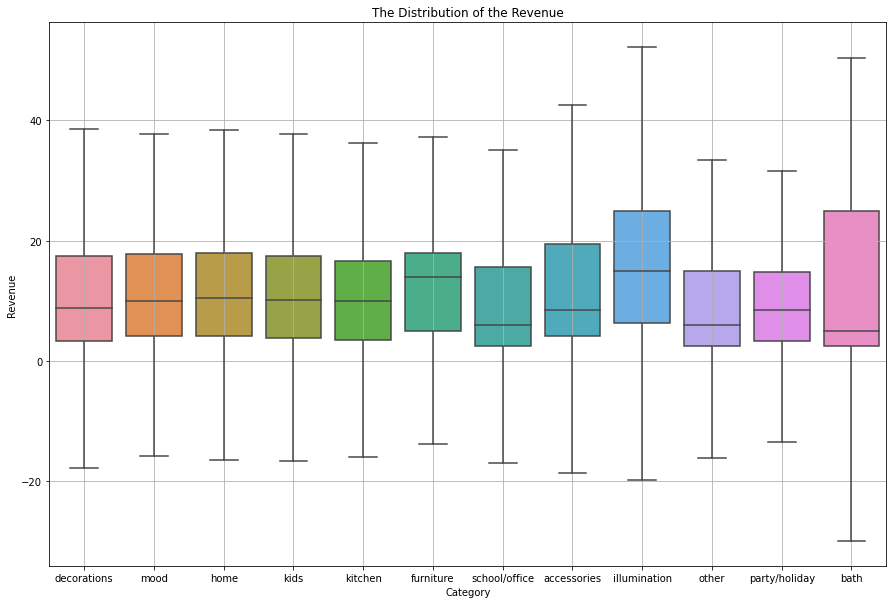

In [60]:
plt.figure(figsize=(15,10))
ax = sns.boxplot(data=e_comm_products, x='category', y='total', showfliers=False)
plt.grid()
plt.title('The Distribution of the Revenue')
plt.xlabel('Category')
plt.ylabel('Revenue')
plt.show()

The highest median is in illumination category. It has a wide spread as well.  
The category with the widest spread is bath and it has the lowest median.   
There is no great variation in the medians between the categories.    


## Testing the Hypotheses


I will compare the proportions of the top two categories in revenue and top two categories in number of items sold.  
In both tests we will use the test that compares two different populations (ttest.ind). The statistical significance level, alpha, is set to 5% as this is the industry standard.


In [61]:
decorations = e_comm_products[e_comm_products['category'] == 'decorations']
kitchen = e_comm_products[e_comm_products['category'] == 'kitchen']
home = e_comm_products[e_comm_products['category'] == 'home']

### Units Sold Test


H0: Proportions of category "decorations" == proportions of category "kitchen"    
H2: Proportions of category "decorations" != proportions of category "kitchen"


In [62]:
dec_var = np.var(decorations['quantity'])
kitch_var = np.var(kitchen['quantity'])
print(dec_var)
print(kitch_var)

82070.33006299337
1841.5209825131133


Variation for each group was calculated. As they are not equal, equal_var will be set to false. 


In [63]:
alpha = 0.05

results = st.ttest_ind(decorations['quantity'], kitchen['quantity'], equal_var=False)

print('The p value is', results.pvalue)

if results.pvalue < alpha:
    print('We reject the Null Hypothesis')
else:
    print('We cannot reject the Null Hypothesis')

The p value is 0.34841467047108443
We cannot reject the Null Hypothesis


P_value is higher than alpha, so the Null Hypothesis cannot be rejected. The groups are probably statistically the same, however it canot be stated for sure.   


### Revenue

H0: Proportions of "decorations" == proportions of category "home"     
H2: Proportions of "decorations" != proportions of category "home"


In [64]:
dec_var = np.var(decorations['total'])
home_var = np.var(home['total'])
print(dec_var)
print(home_var)

356291.52880200255
120106.69498066453


Variation for each group was calculated. As they are not equal, equal_var will be set to false. 


In [65]:
alpha = 0.05

results = st.ttest_ind(decorations['total'], home['total'], equal_var=False)

print('The p value is', results.pvalue)

if results.pvalue < alpha:
    print('We reject the Null Hypothesis')
else:
    print('We cannot reject the Null Hypothesis')

The p value is 0.4044529008332919
We cannot reject the Null Hypothesis


P_value is higher than alpha, so the Null Hypothesis cannot be rejected. The groups are probably statistically the same, however it canot be stated for sure. 


## Conclusions


The dataset was large and required quite a bit of preprocessing before getting to work.  

From the onset, there were missing values found in two columns. I decided not to fill or drop the missing values from the customer id column as those were irrelevant for my analysis. The rows with missing values in the description all had 0 in the unit price column, so they were dropped.  
There were other rows with 0 in the unit price column, those were dropped as well as they could have interfered with my analysis.  

Column names were amended.  
Columns were transformed to correct types.  
Description column was unified to be lower case.   
Columns for date, month and total revenue were created.     
Duplicates were identified, examined and deleted.   

When analyzing the event distribution, I found that the site was not opperational during the winter holidays and Easter.   

The data was divided into 13 categories: 'decorations', 'mood', 'home', 'kids', 'kitchen', 'furniture', 'school/office', 'accessories', 'illumination', 'other charges', 'other', 'party/holiday', 'bath'. 'Other charges' includes data not relevant for the analysis so it was removed.   
The top 3 categories in terms of unique items are decorations, home and kitchen.  

Quantity:  

There is a general trend seen across most categories of sales going down in the winter months (December and on) and picking back up starting from April.  
Top category is decorations with 1538029 items sold.  
The category with the highest average per invoice is party/holiday with 13.46. It has the highest median as well.  
I identified the unique item with the highest number of units sold for each category.   

Revenue:   

Similar to quantity, the top categories in revenue show lower sales in the winter months.  
Top category is decorations with 2962688 in revenue.   
The category with the highest average per invoice is illumination with 32.23. It has the highest median as well.   
I identified the unique item with the highest revenue for each category.     

Testing the hypotheses:   

I conducted two tests. One for the top two categories in terms of item sold and one for the top two categories in terms of revenue.    
In both cases the variance between the group was not equal, so equal_var was set to false.  
The alpha was set to 0.05 as per industry standard.  
In both cases, I could not reject the Null Hypothesis and conclude that the groups are probably the same statistically.  

Answering the posed questions:   

1. Are there specific product categories that can be inferred from the data?   

Yes, 12 of them. 


2. What category is more profitable?   

In both cases decorations category came on top. So I conclude that it is the most profitable.     


3. Do different categories sell differently on different months?   

Yes, in general sales slow down in the winter and go up again in the spring/summer reaching a peak in November/December. 


4. What is the best-selling product revenue-wise / units sold-wise?  

Unit-wise - world war 2 gliders asstd designs with 53751 units sold. It is from the kids category.  
Revenue-wise - regency cakestand 3 tier  with 164459.49 in revenue. It is from the kitchen category.  

Interesting to note, none of them belong to the top category identified.   
